In [2]:
import os
import cv2
import skimage
import numpy as np
from matplotlib import pyplot as plt

In [3]:
def plot_images(img1, img2):
    plt.figure(figsize=(20,10))
    ax1 = plt.subplot(121)
    ax1.imshow(img1)
    ax2 = plt.subplot(122)
    ax2.imshow(img2)
    plt.show()

def plot_img(img):
    plt.figure(figsize=(20,10))
    plt.imshow(img)
    plt.show()

In [4]:
import math

def cropping_near_center(image, th):
    """Cropping near the center"""
    contours, _ = cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    center = image.shape / 2
    if len(contours) <= 10:
        stats = {"cont":0, "centr":0, "dist":0}
        for contour in contours:
            M = cv2.moments(contour)
            if M['m00'] != 0:
                cx = int(M['m10']/M['m00'])
                cy = int(M['m01']/M['m00'])
            dist = math.sqrt((x - cx)**2 + (y - cy)**2)
            stats["cont"] = contour
            stats["centr"] = [cx,cy]
            stats["dist"] = dist


In [5]:
def cropping_to_conts(image, th):
    """Cropping to the union of the two maximum contours found"""
    contours, _ = cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 1:
        (x,y,w,h) = cv2.boundingRect(contours[0]) # computes the bounding box for the contour
        cropped_image = image[y:y+h, x:x+w]
        coordinates = (x,y,w,h)
    elif len(contours) == 2:
        (x0,y0,w0,h0) = cv2.boundingRect(contours[0])
        (x1,y1,w1,h1) = cv2.boundingRect(contours[1])
        x, y = min(x0,x1), min(y0,y1)
        h = max(y0+h0, y1+h1) - y
        w = max(x0+w0, x1+w1) - x
        cropped_image = image[min(y0,y1):max(y0+h0,y1+h1), min(x0,x1):max(x0+w0,x1+w1)]
        coordinates = (x,y,w,h)
    else:
        return None
    return cropped_image, coordinates

In [6]:
def thresholding(image, kernel_size):
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5,5), 0)
    _, th = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    th = cv2.morphologyEx(th, cv2.MORPH_CLOSE, np.ones((kernel_size,kernel_size),np.uint8))
    # th = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)  # Adaptive Thresholding
    # th = cv2.erode(th, np.ones((10, 10), np.uint8), iterations=1)
    # th = cv2.dilate(th, np.ones((10, 10), np.uint8), iterations=1)
    return th

In [7]:
def cropping_to_max_cont(image, th):
    """Cropping to the maximum contour found"""
    contours, _ = cv2.findContours(th, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if len(contours) == 0:
        return None
    contour = max(contours, key = cv2.contourArea)
    (x,y,w,h) = cv2.boundingRect(contour) # computes the bounding box for the contour
    cropped_image = image[y:y+h, x:x+w]
    coordinates = (x,y,w,h)
    return cropped_image, coordinates, len(contours)

In [8]:
def center_cropping(image, h, w):
    center = (image.shape[0]/2, image.shape[1]/2)
    x = center[1] - w/2
    y = center[0] - h/2
    crop_image = image[int(y):int(y+h), int(x):int(x+w)]
    return crop_image

In [9]:
def border_padding(image, image_to_pad, coord, thick_to_add):
    """Adding a frame of such a thickness to the image"""
    x,y,w,h = coord
    max_dim = h if h>w else w
    padded_image = cv2.vconcat([image[y-thick_to_add:y, x:x+max_dim], image_to_pad])
    padded_image = cv2.vconcat([padded_image, image[y+max_dim:y+max_dim+thick_to_add, x:x+max_dim]])
    padded_image = cv2.hconcat([image[y-thick_to_add:y+max_dim+thick_to_add, x-thick_to_add:x], padded_image])
    padded_image = cv2.hconcat([padded_image, image[y-thick_to_add:y+max_dim+thick_to_add, x+max_dim:x+max_dim+thick_to_add]])
    return padded_image

In [10]:
def hair_removal(image):
    """Removing hair from skin images"""
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5,5), 0)
    blackhat = cv2.morphologyEx(gray, cv2.MORPH_BLACKHAT, cv2.getStructuringElement(cv2.MORPH_CROSS, (17,17))) # Perform the blackHat filtering on the grayscale image to find the hair countours
    # plot_images(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), blackhat)
    _, th = cv2.threshold(blackhat, 10, 255, cv2.THRESH_BINARY) # intensify the hair countours in preparation for the inpainting algorithm
    th = skimage.morphology.remove_small_objects(th.astype(bool), 700, connectivity=3).astype(np.uint8)
    th = cv2.dilate(th, cv2.getStructuringElement(cv2.MORPH_CROSS, (3,3)), iterations=1)
    # plot_images(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), th)
    inpaint = cv2.inpaint(image, th, 1, cv2.INPAINT_TELEA) # inpaint the original image depending on the mask
    return inpaint

In [11]:
def sliding_window(image, stepSize, windowSize):
    """slide a window across the image"""
    for y in range(0, image.shape[0], stepSize):
	    for x in range(0, image.shape[1], stepSize):
			# yield the current window
		    yield (x, y, image[y:y + windowSize[1], x:x + windowSize[0]])

In [11]:
# elif height<=1600:
                            #     if width<=1600:
                            #         final_image = center_cropping(image, min(height,width), min(height,width))
                            #     elif 1600<width<=2600:
                            #         final_image_a = image[(height-HIGH_RES)//2:(height+HIGH_RES)//2, width//2-HIGH_RES:width//2]
                            #         final_image_b = image[(height-HIGH_RES)//2:(height+HIGH_RES)//2, width//2:width+HIGH_RES]
                            #     elif 2600<width<=3600:
                            #         final_image_a = image[(height-HIGH_RES)//2:(height+HIGH_RES)//2, (width-HIGH_RES)//2-HIGH_RES:(width-HIGH_RES)//2]
                            #         final_image_b = image[(height-HIGH_RES)//2:(height+HIGH_RES)//2, (width-HIGH_RES)//2:(width+HIGH_RES)//2]
                            #         final_image_c = image[(height-HIGH_RES)//2:(height+HIGH_RES)//2, (width+HIGH_RES)//2:(width+HIGH_RES)//2+HIGH_RES]
                                
                            
                            # elif 1600<height<=2600:
                            #     final_image_a = image[]


                            # else:
                            #     if height <= HIGH_RES*3 or width <= HIGH_RES*3:
                            #         (winW, winH) = (HIGH_RES, HIGH_RES)
                            #         STEPSIZE = HIGH_RES
                            #     elif height > HIGH_RES*3 or width > HIGH_RES*3:
                            #         (winW, winH) = (HIGH_RES*2, HIGH_RES*2)
                            #         STEPSIZE = 2*HIGH_RES

                            #     for (x, y, window) in sliding_window(image, stepSize=STEPSIZE, windowSize=(winW, winH)):
                            #     # if the window does not meet our desired window size, ignore it
                            #         if window.shape[0] != winH  or window.shape[1] != winW:
                            #             continue
                            #         else:
                            #             final_image = window 

## Dark Coner + Window Crop

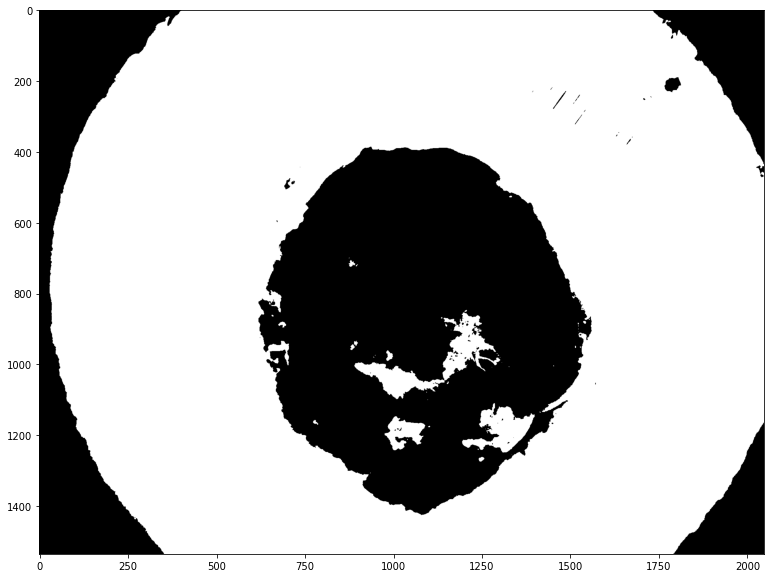

Sx e Dx:  0.0 124.12158203125
Up e Down:  167.953857421875 180.903076171875
Height e Width: 1536 2048


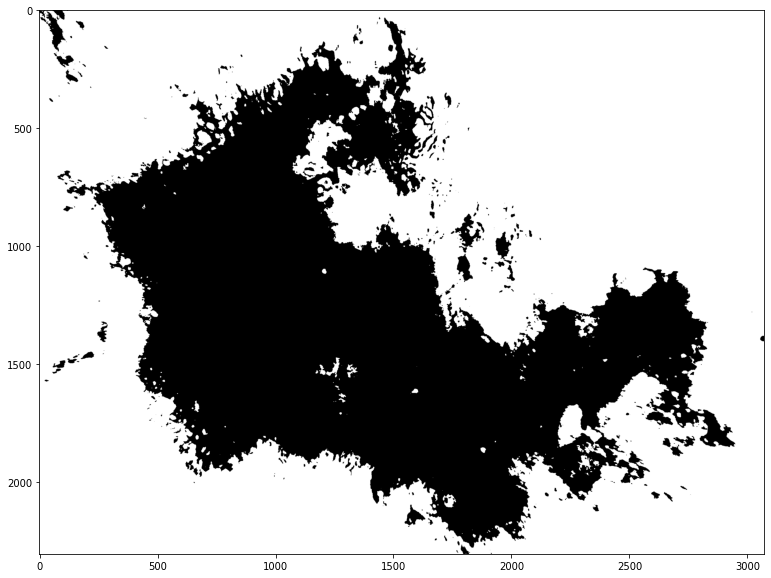

Sx e Dx:  252.91373697916666 253.3564453125
Up e Down:  250.26025390625 252.729736328125
Height e Width: 2304 3072


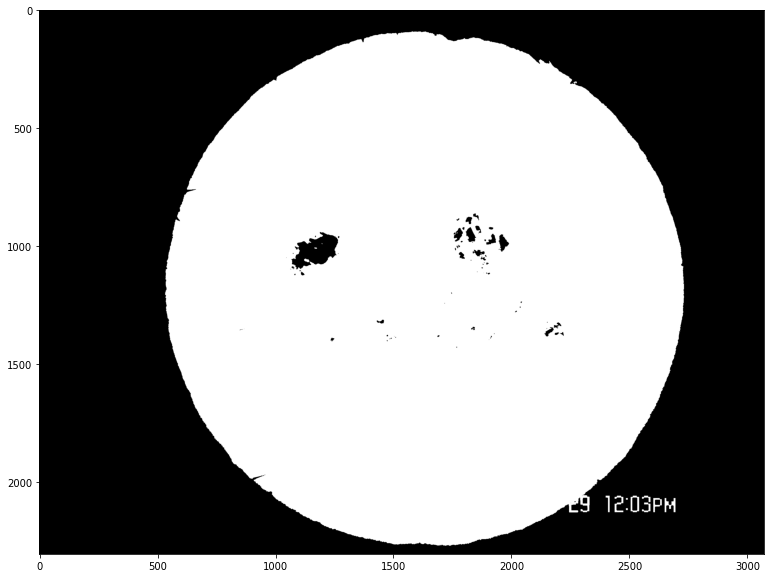

Sx e Dx:  0.0 0.0
Up e Down:  0.0 0.0


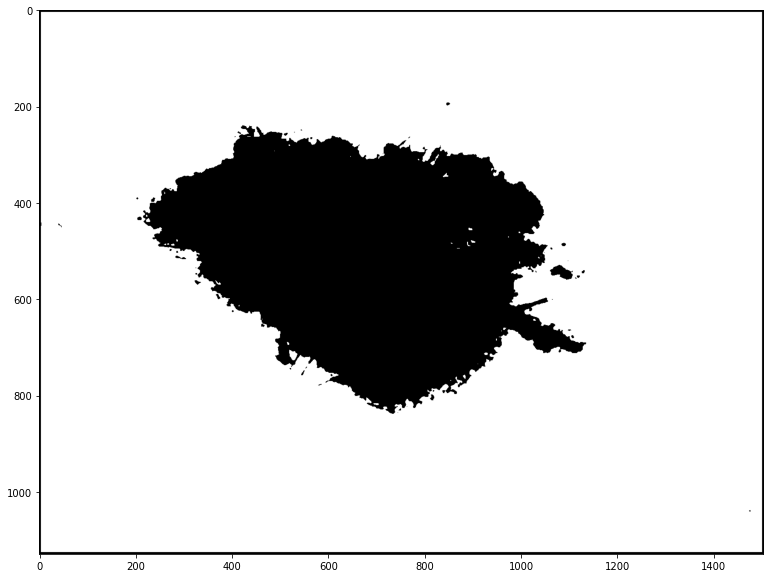

Sx e Dx:  202.49800708591675 202.5770593445527
Up e Down:  202.9318484042553 202.9318484042553
Height e Width: 1129 1504


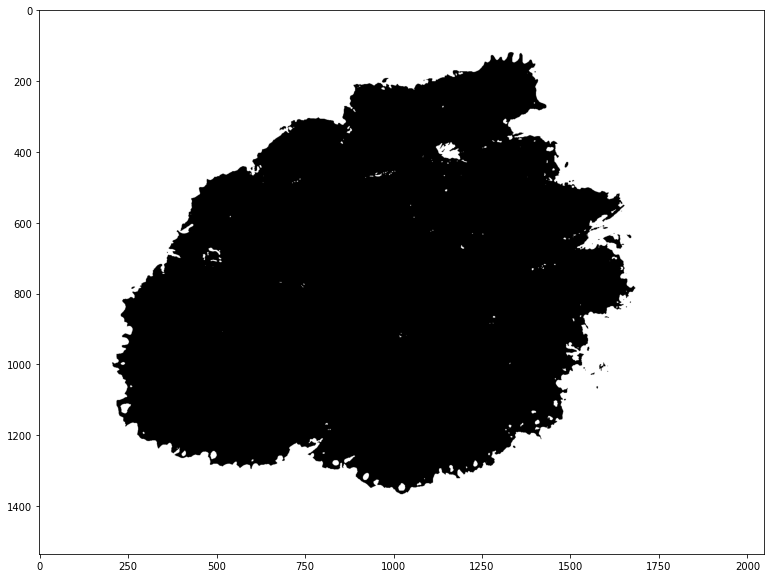

Sx e Dx:  255.0 255.0
Up e Down:  255.0 255.0
Height e Width: 1536 2048


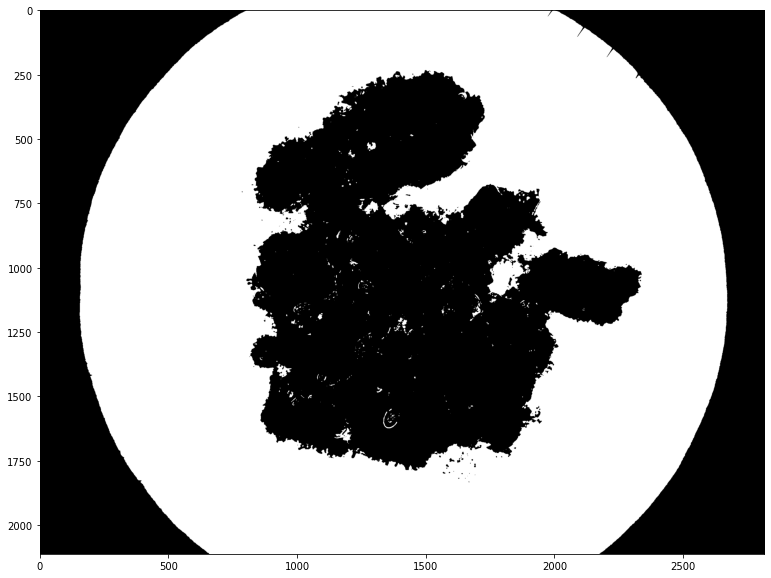

Sx e Dx:  0.0 0.0
Up e Down:  111.4764737215909 139.4667080965909
Height e Width: 2112 2816


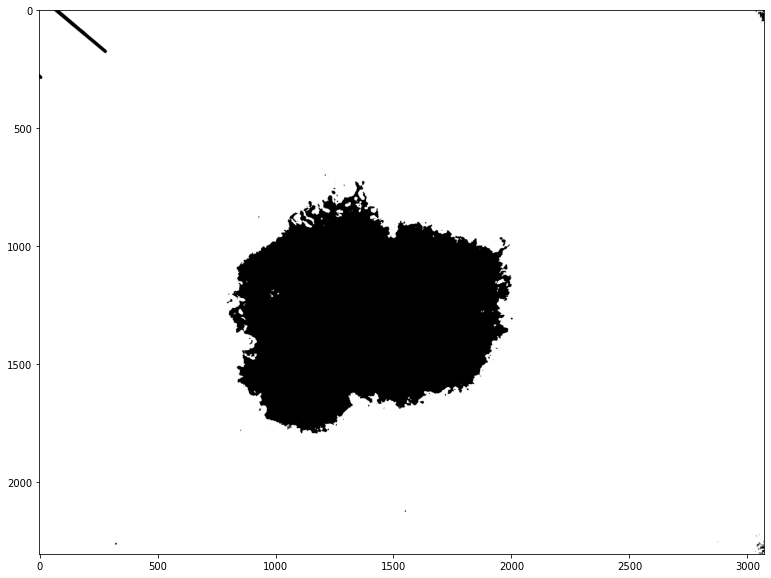

Sx e Dx:  253.81022135416666 249.7373046875
Up e Down:  251.712890625 254.34423828125
Height e Width: 2304 3072


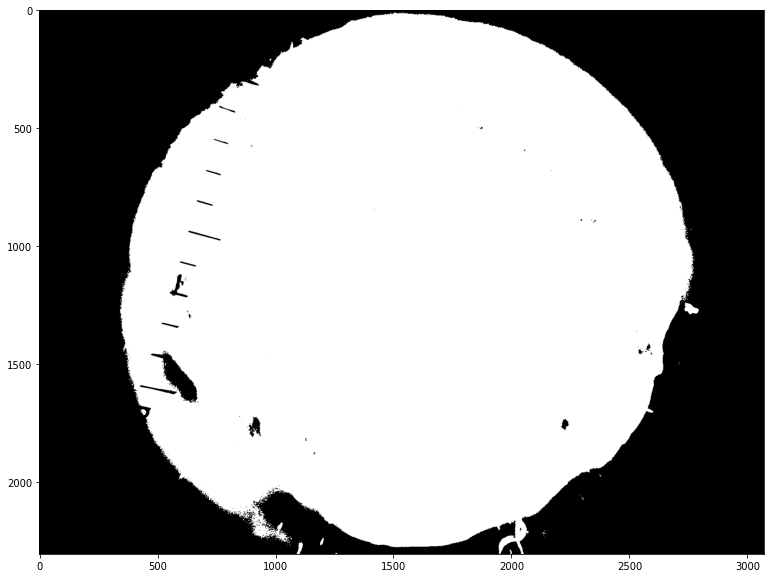

Sx e Dx:  0.0 0.0
Up e Down:  3.29541015625 3.32861328125


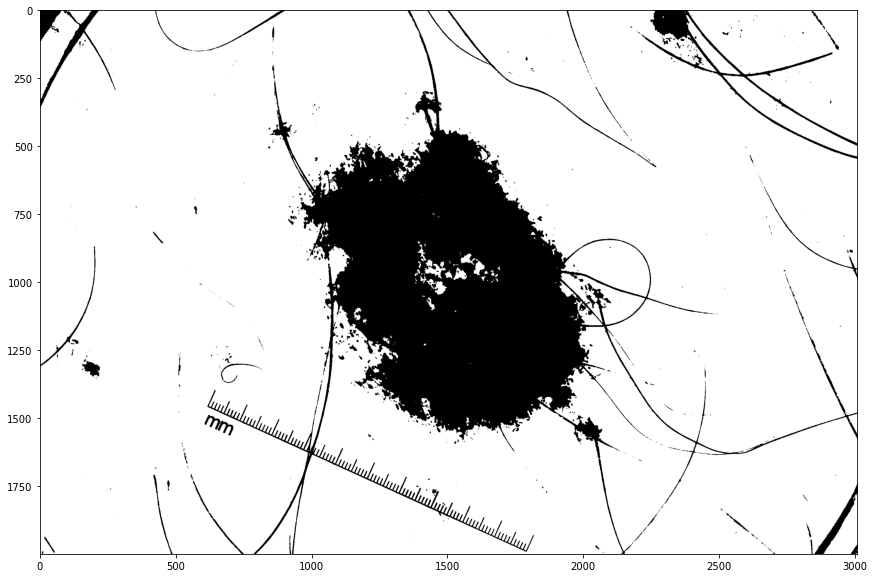

Sx e Dx:  236.895 239.846625
Up e Down:  230.02983710106383 245.38239694148936
Height e Width: 2000 3008
Height_resized e Width_resized: 1024 1540


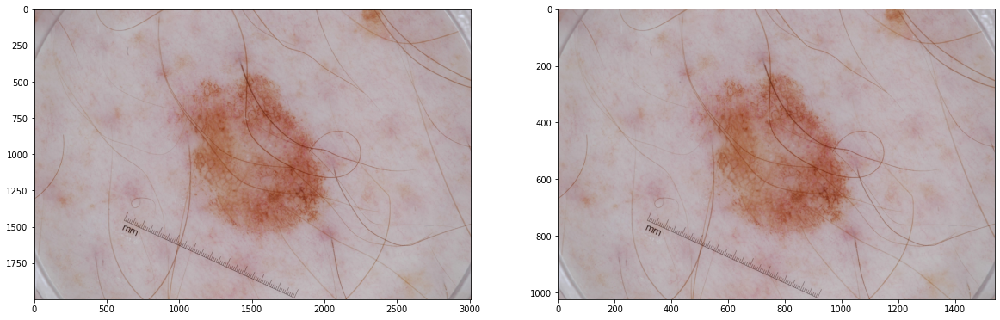

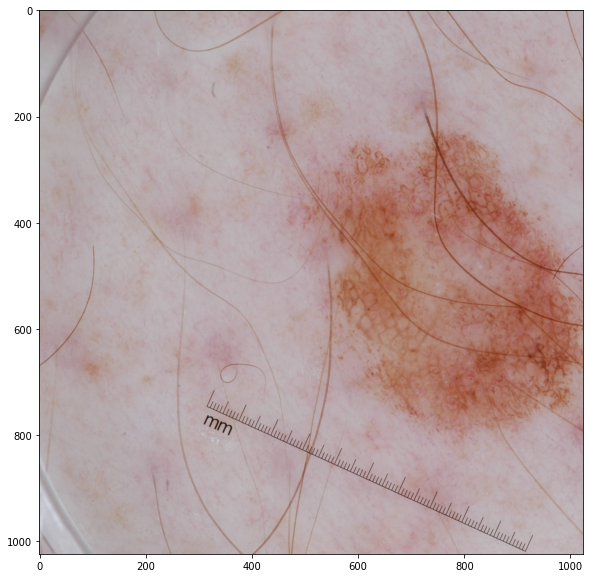

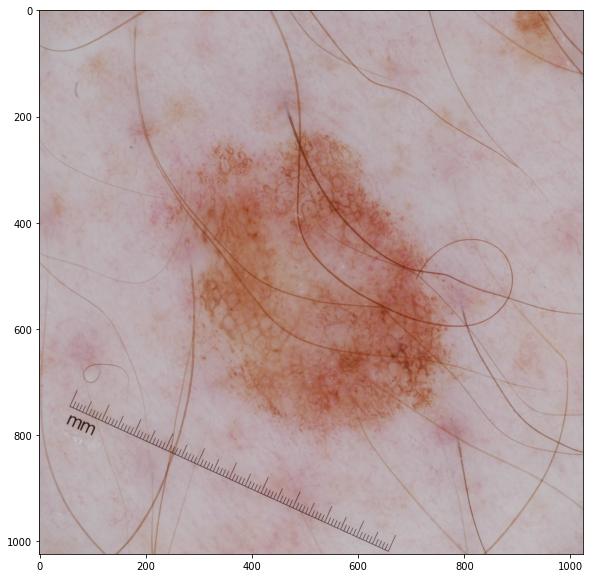

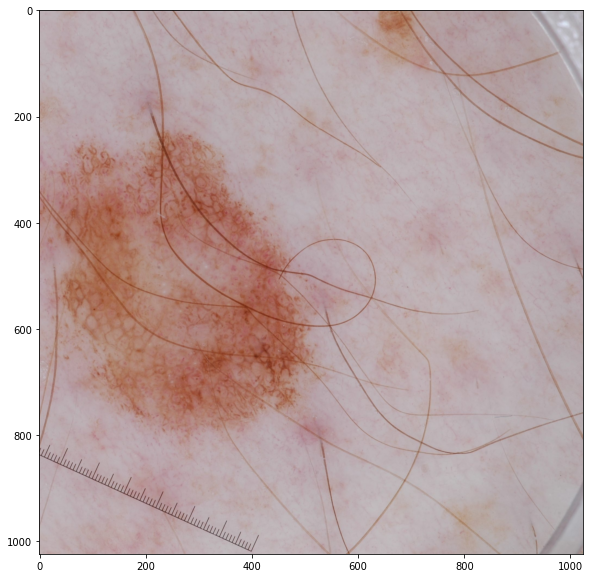

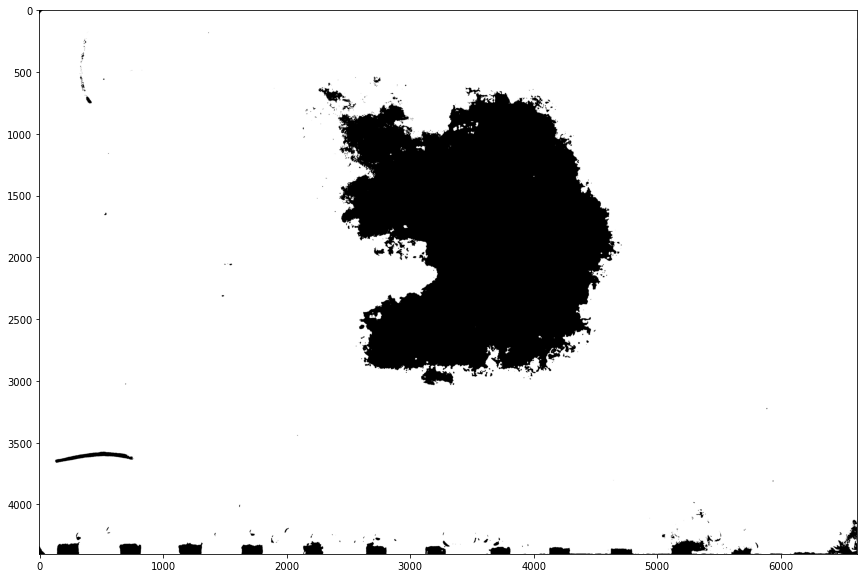

Sx e Dx:  250.65729379686434 242.5918541240627
Up e Down:  254.16425011327593 158.05879021295877
Height e Width: 4401 6621
Height_resized e Width_resized: 1024 1540


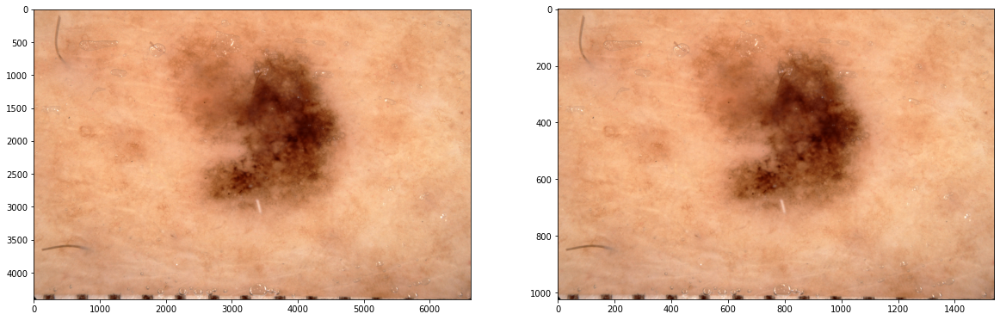

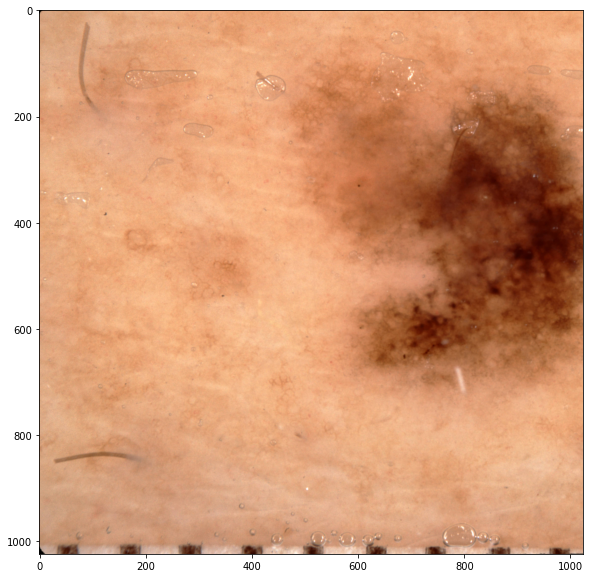

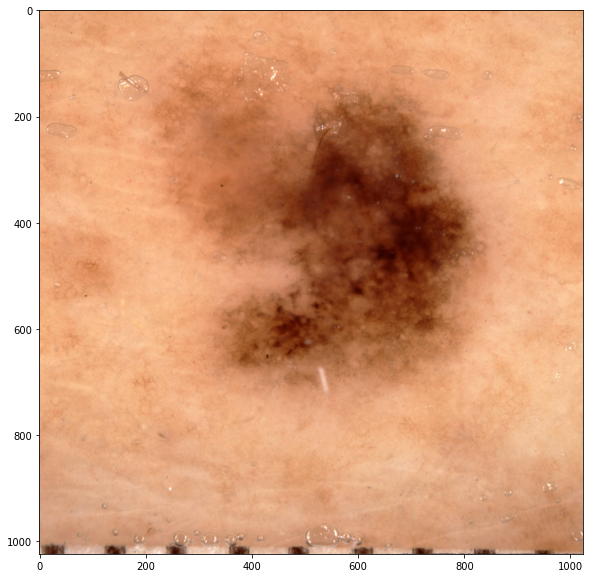

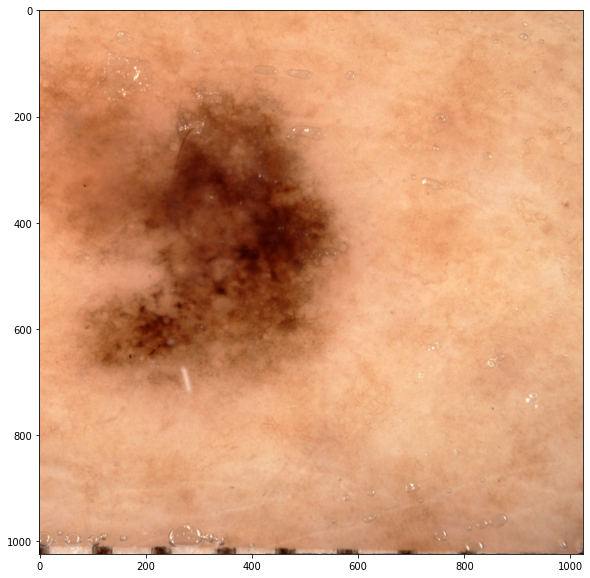

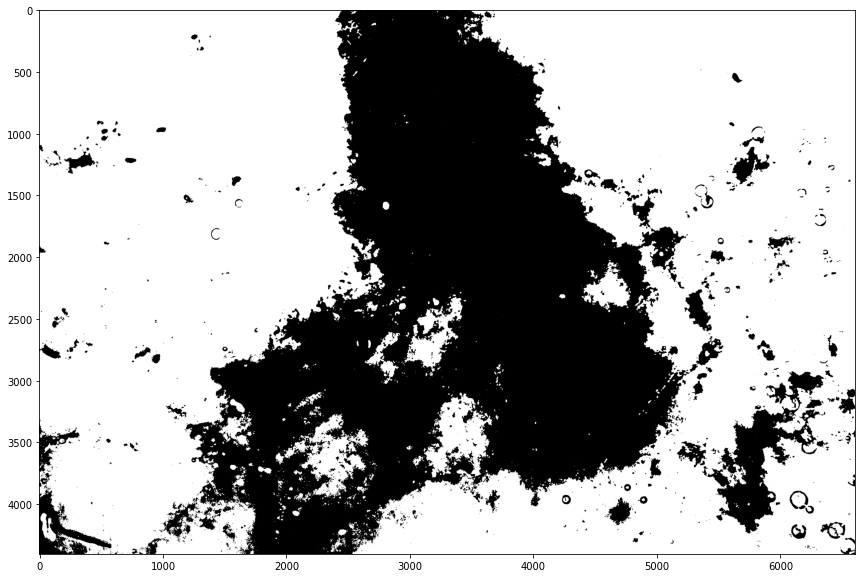

Sx e Dx:  201.05435029532032 240.68883462062698
Up e Down:  214.69709936382915 199.82081187518935
Height e Width: 4402 6602
Height_resized e Width_resized: 1024 1535


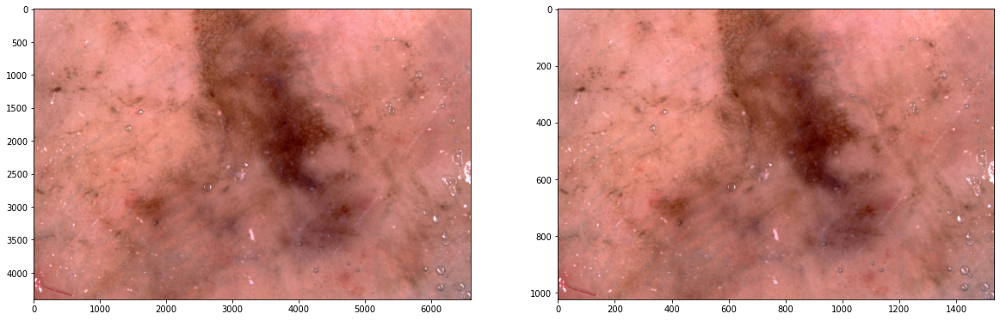

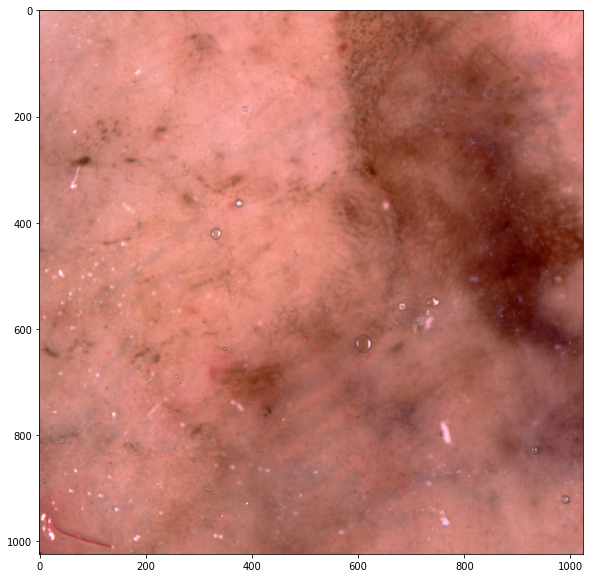

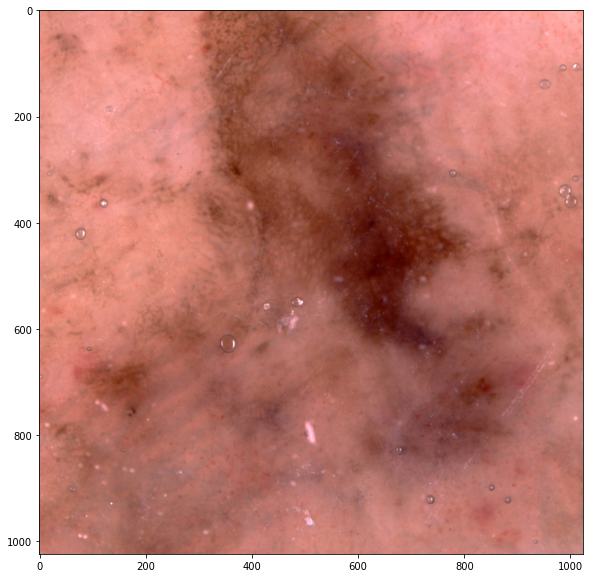

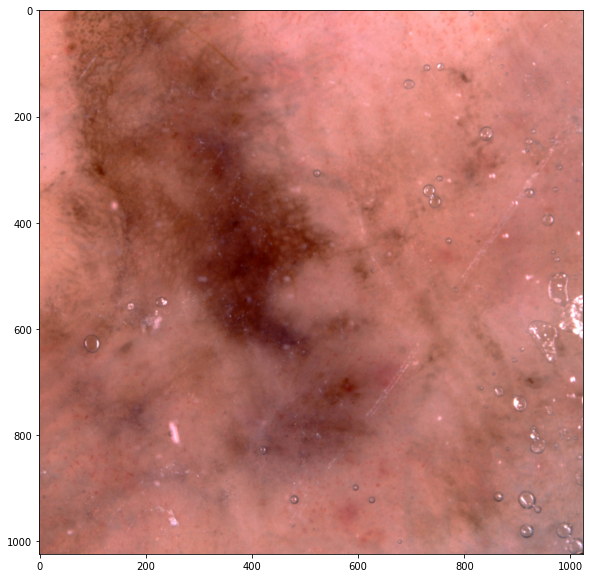

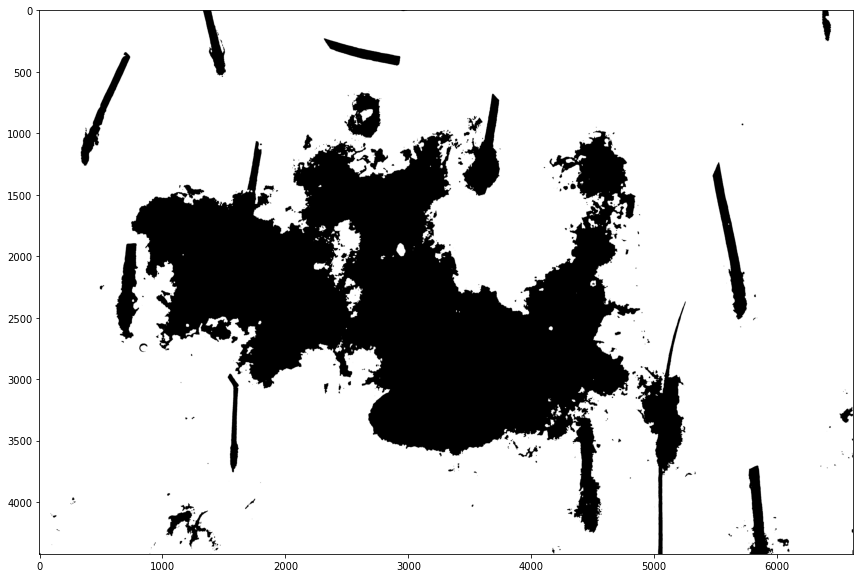

Sx e Dx:  254.76645183175035 250.6865671641791
Up e Down:  250.04134571816945 246.67908926144088
Height e Width: 4422 6621
Height_resized e Width_resized: 1024 1533


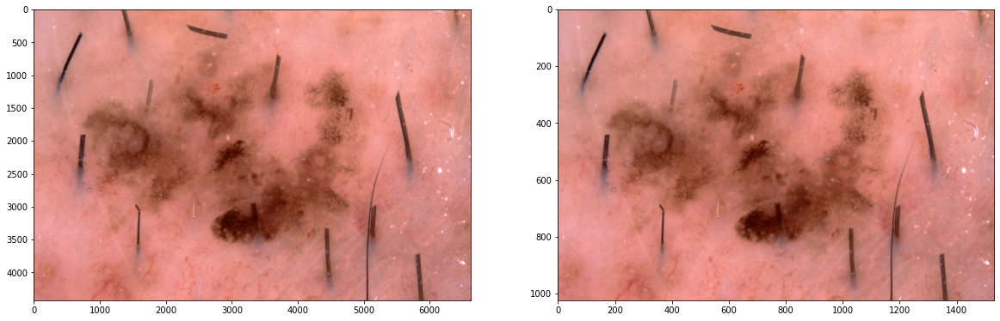

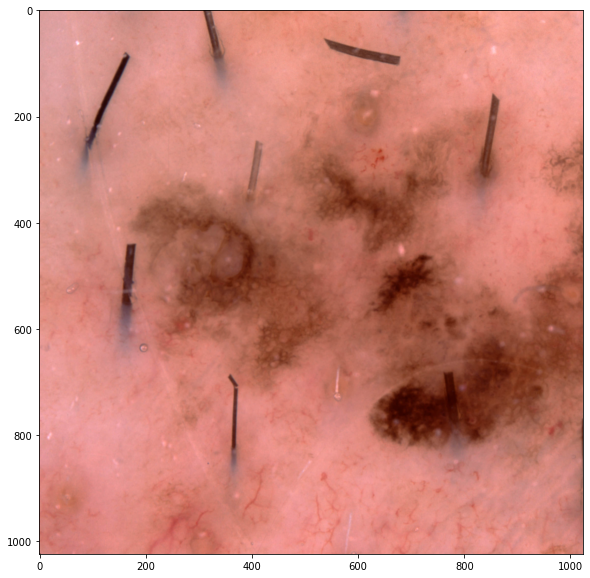

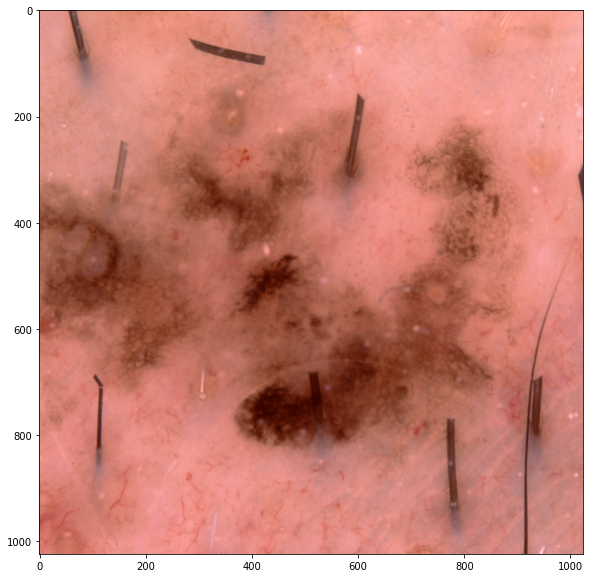

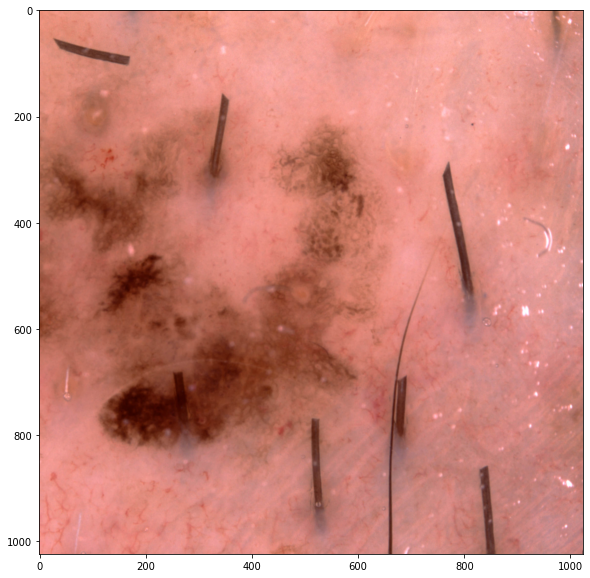

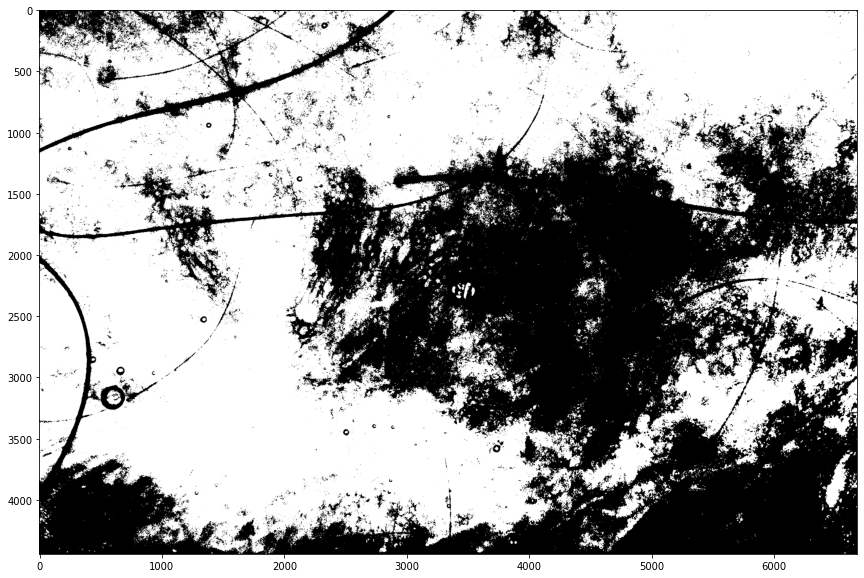

Sx e Dx:  187.0354086917361 146.14124071155146
Up e Down:  200.12022900763358 3.3339694656488548
Height e Width: 4441 6681
Height_resized e Width_resized: 1024 1540


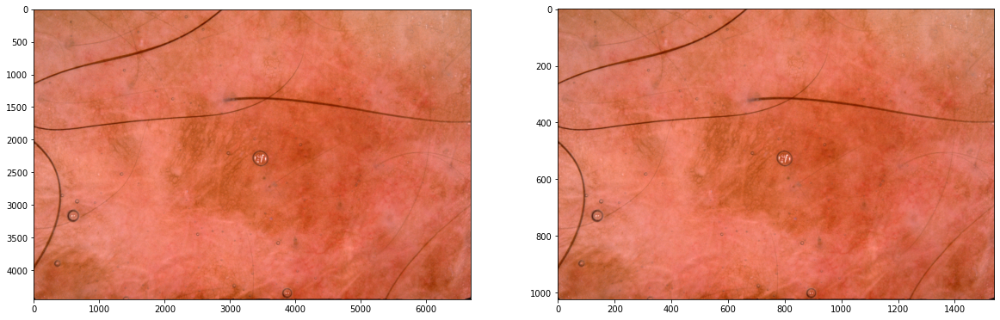

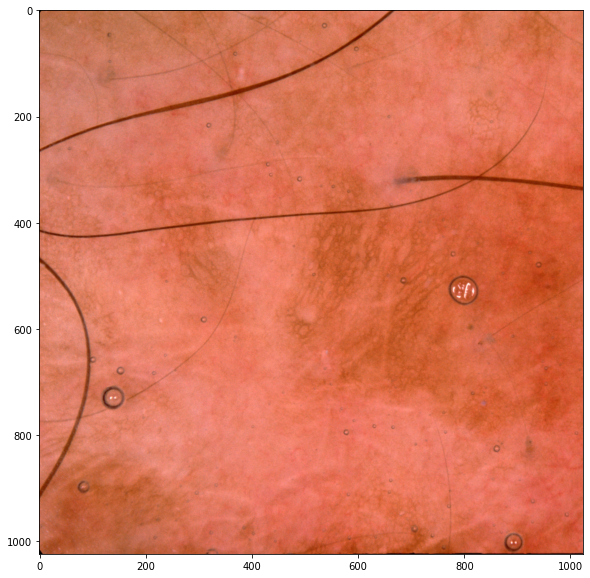

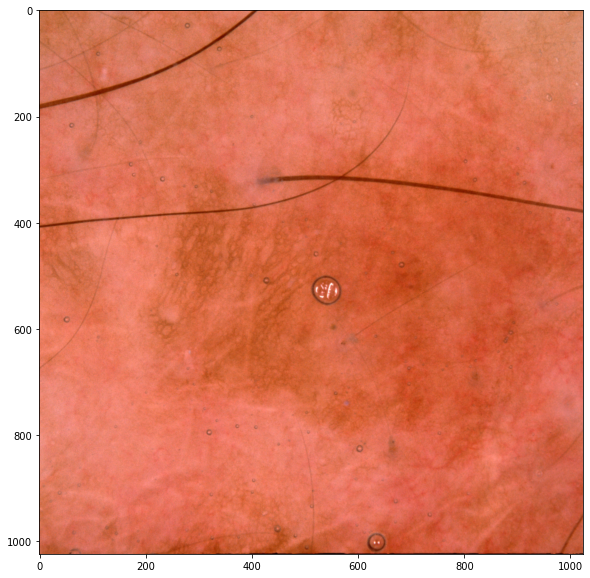

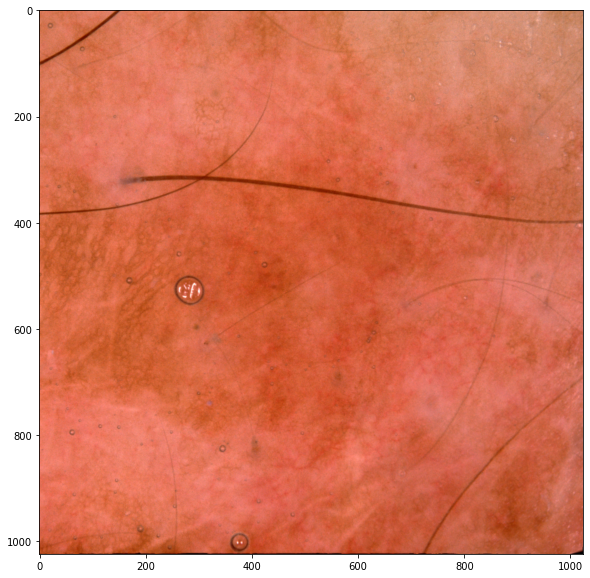

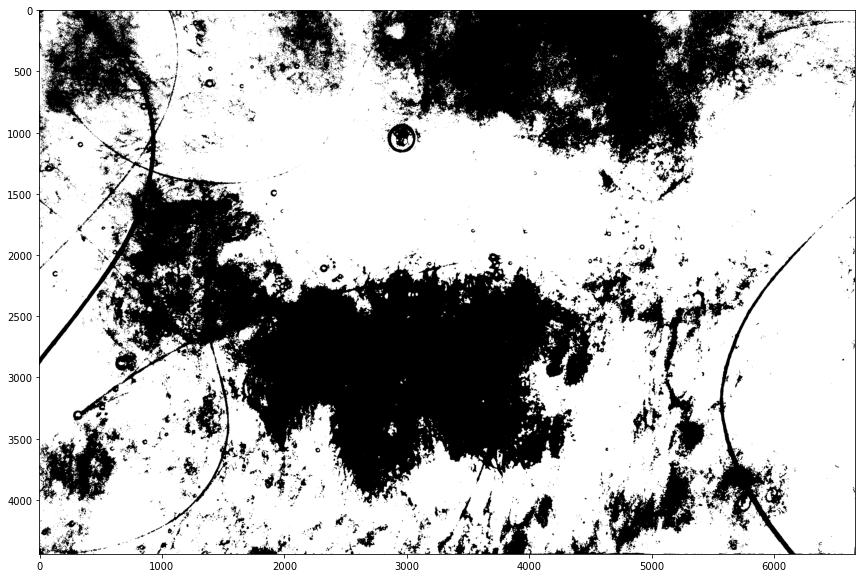

Sx e Dx:  218.4122945282594 244.28265030398558
Up e Down:  107.63710403843267 184.65200420357303
Height e Width: 4441 6661
Height_resized e Width_resized: 1024 1535


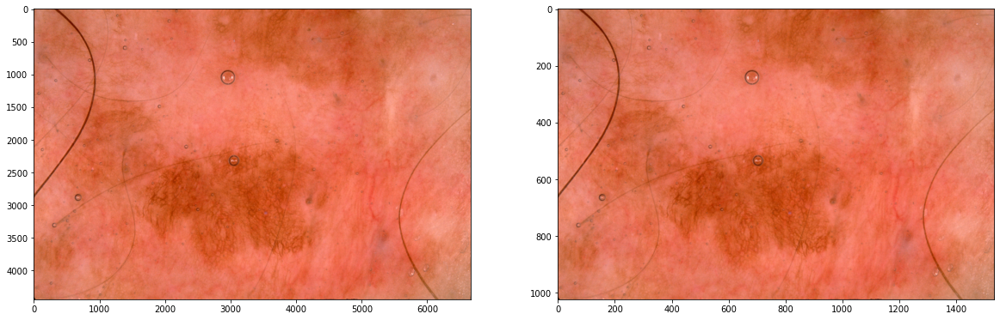

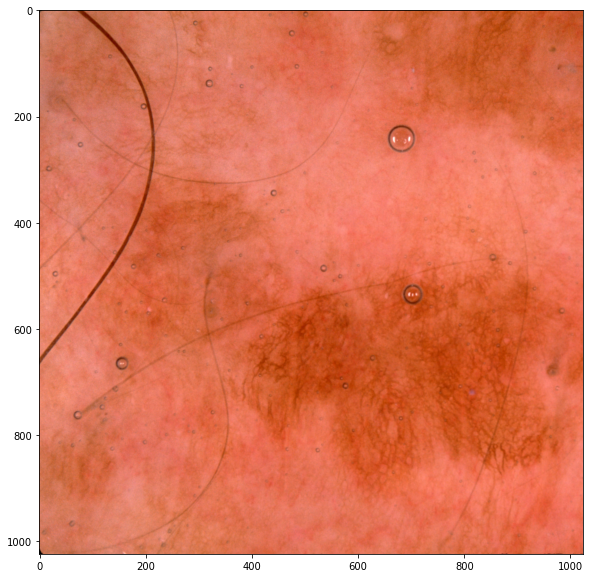

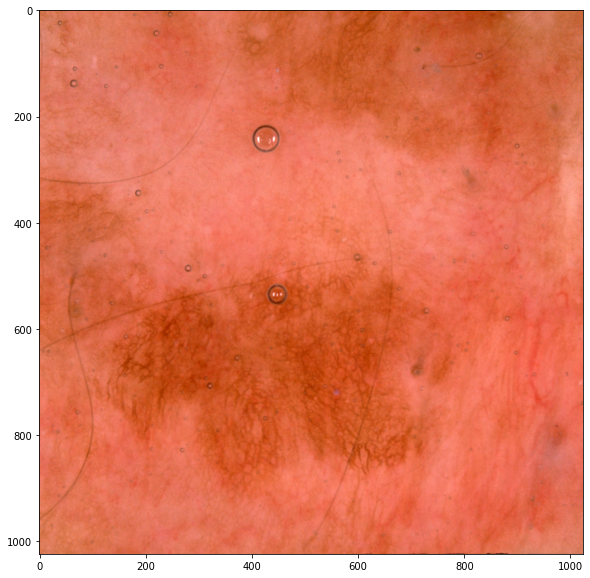

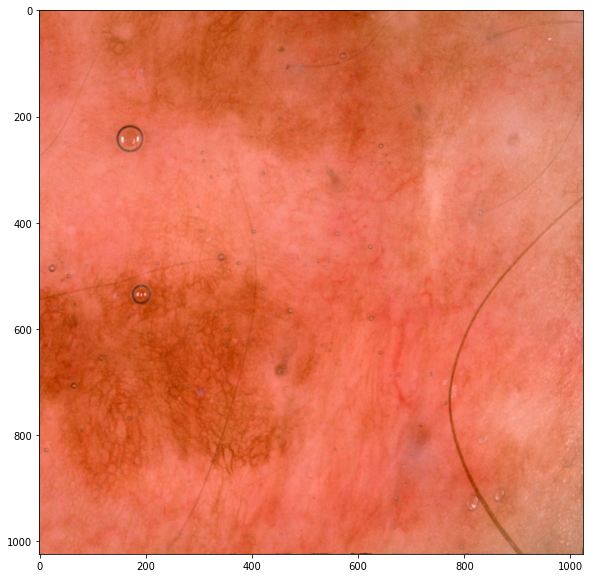

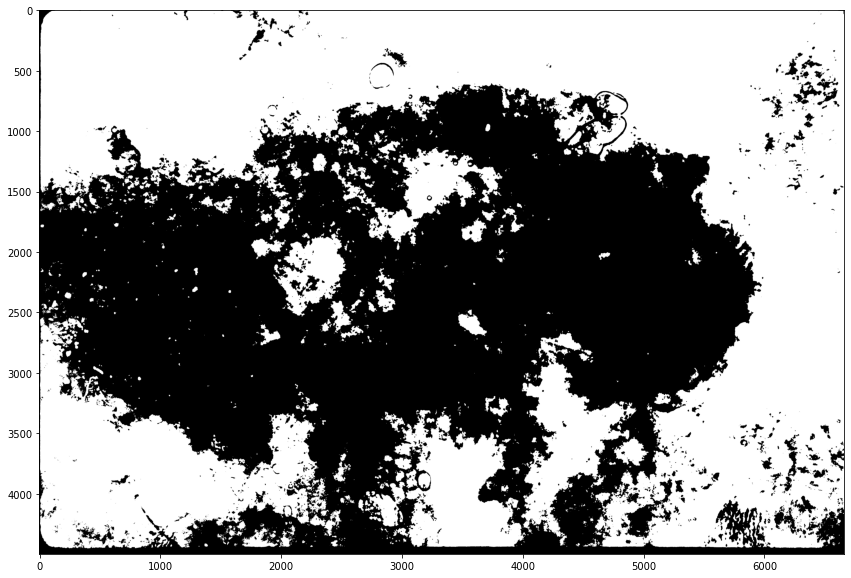

Sx e Dx:  67.91309179817738 227.1818181818182
Up e Down:  245.27623479957964 0.0
Height e Width: 4499 6661
Height_resized e Width_resized: 1024 1516


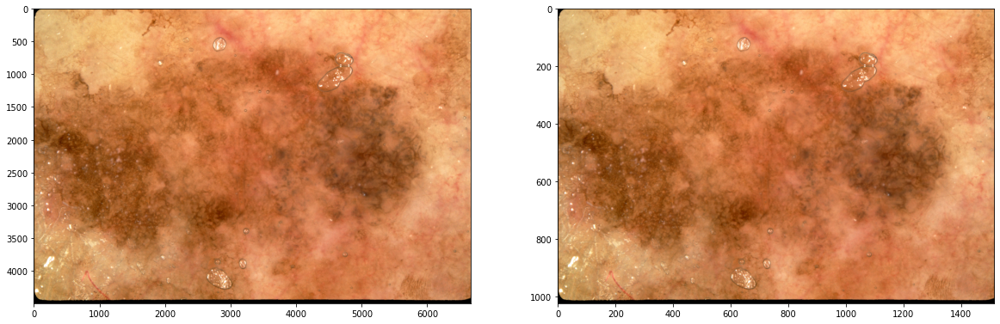

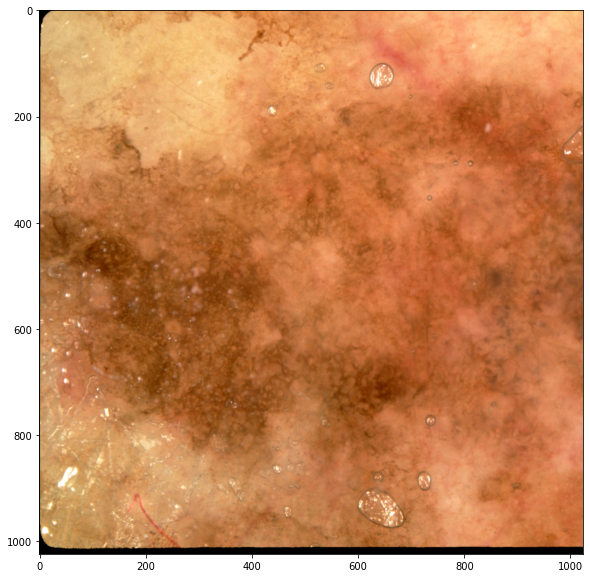

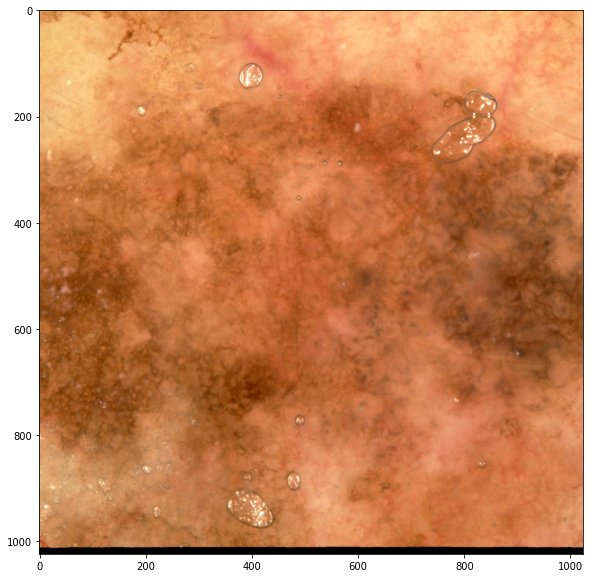

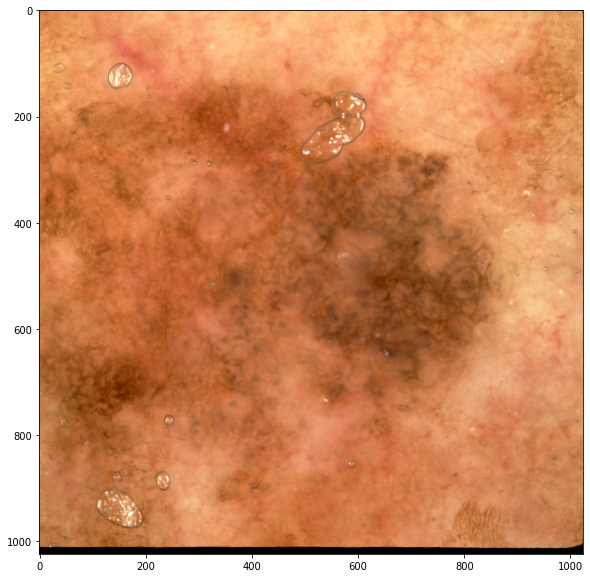

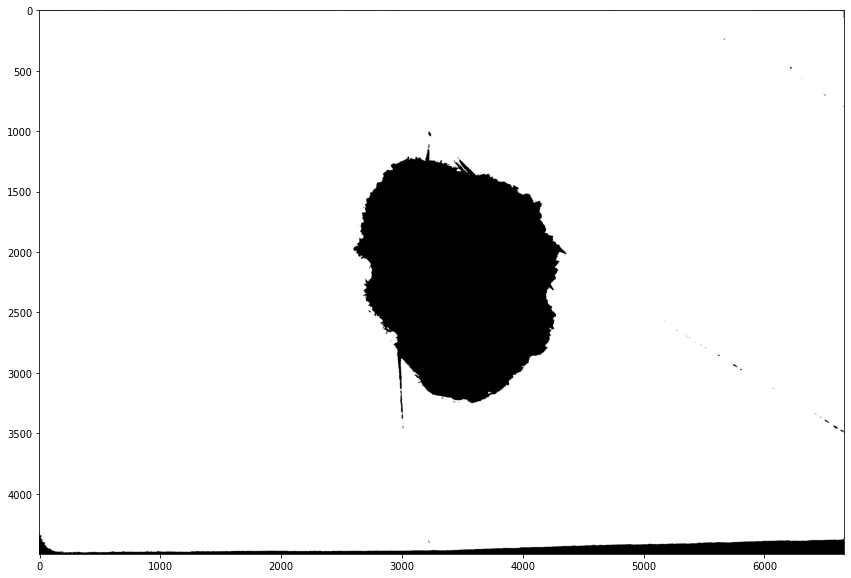

Sx e Dx:  246.08718604134253 246.6596465881307
Up e Down:  238.2609593154181 5.378696892358505
Height e Width: 4499 6661
Height_resized e Width_resized: 1024 1516


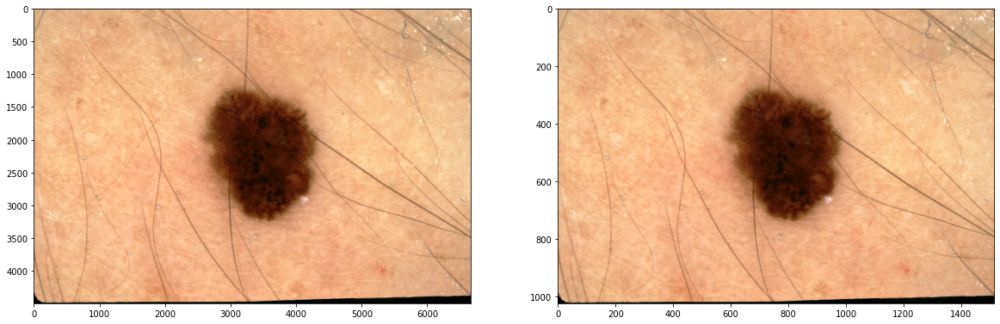

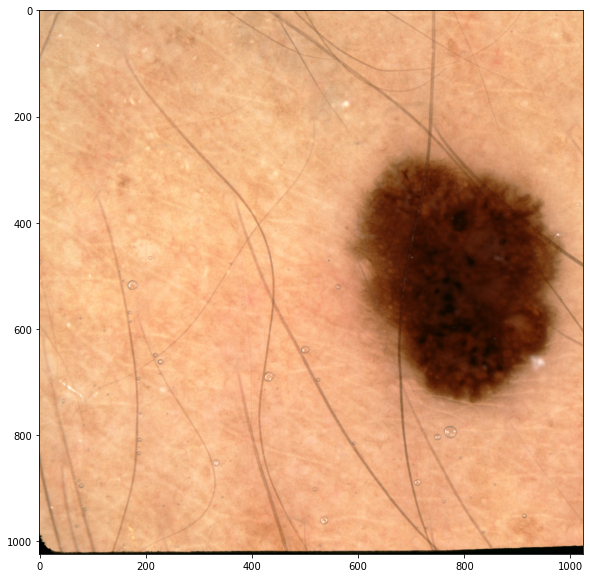

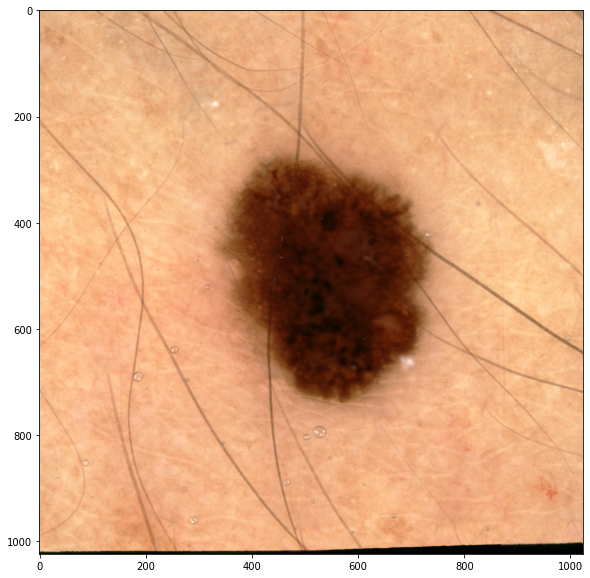

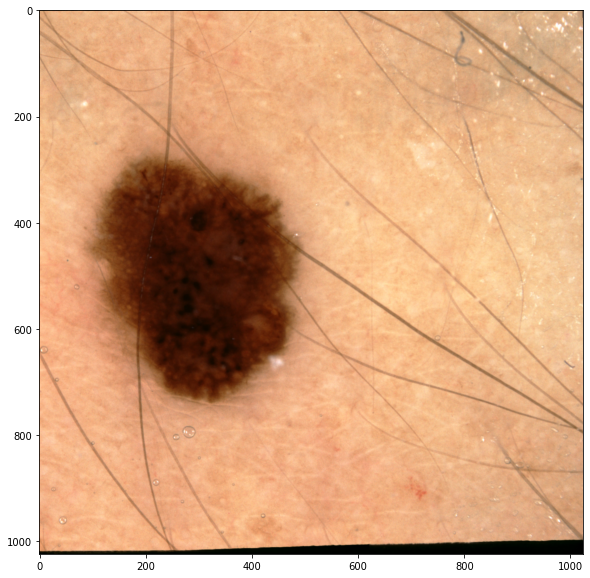

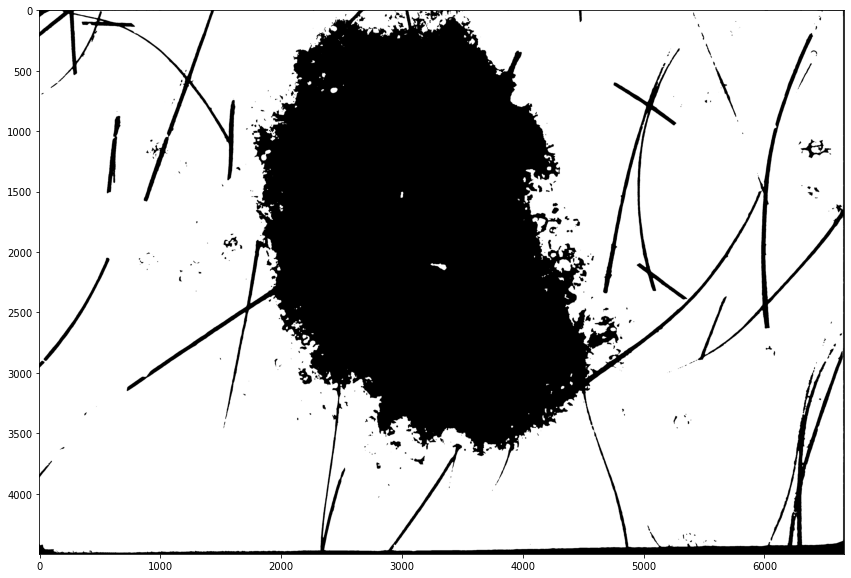

Sx e Dx:  241.7427206045788 158.23432985107803
Up e Down:  235.08542260921783 10.315230445878997
Height e Width: 4499 6661
Height_resized e Width_resized: 1024 1516


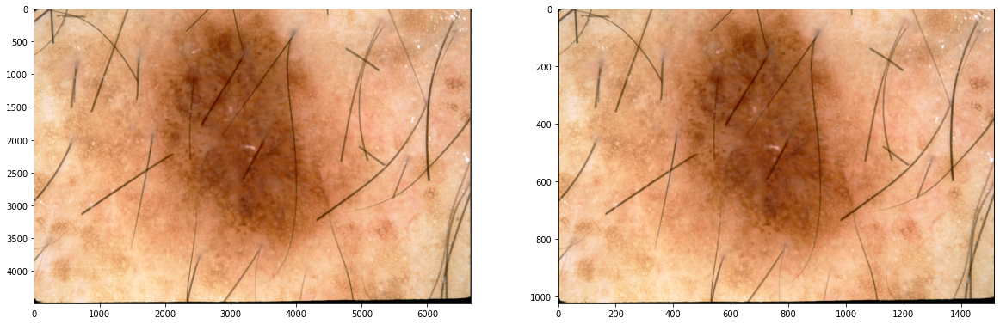

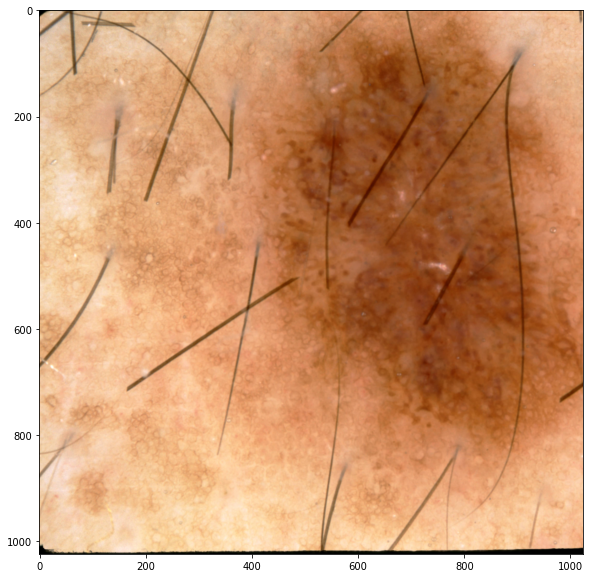

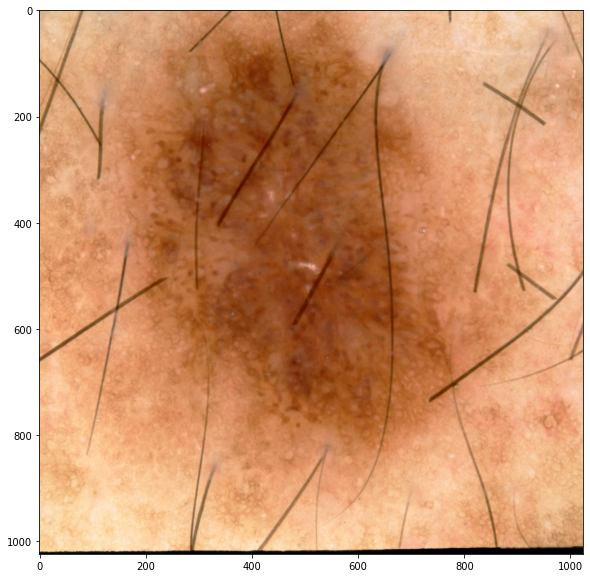

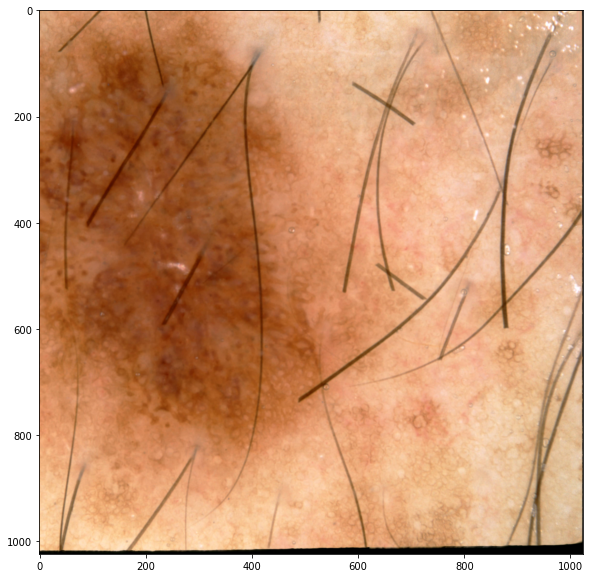

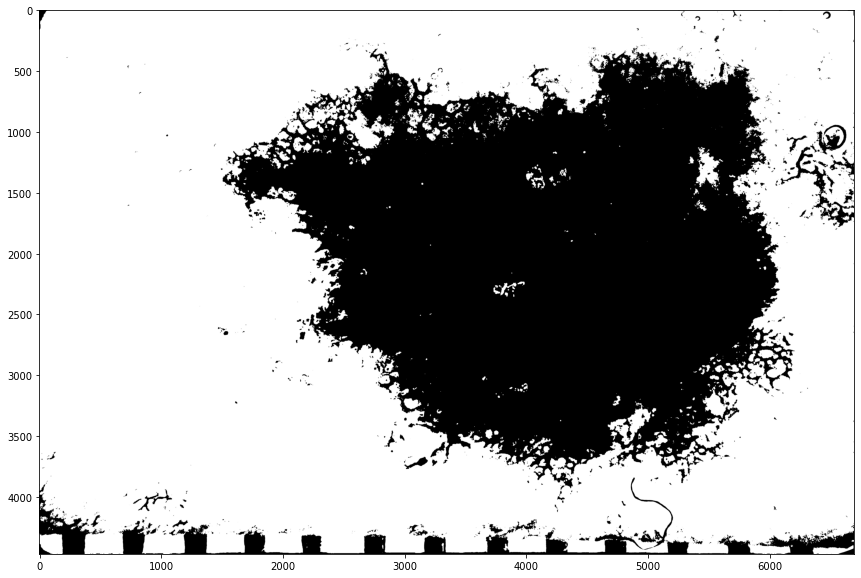

Sx e Dx:  225.8551040967092 233.12491605104097
Up e Down:  251.12453323375652 93.6834578043316
Height e Width: 4467 6695
Height_resized e Width_resized: 1024 1534


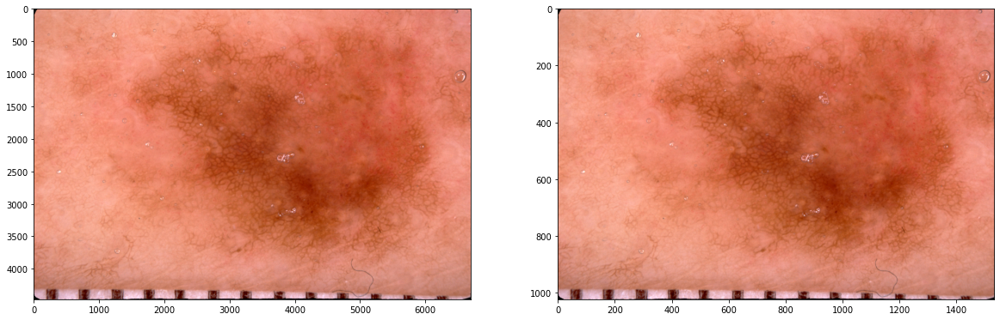

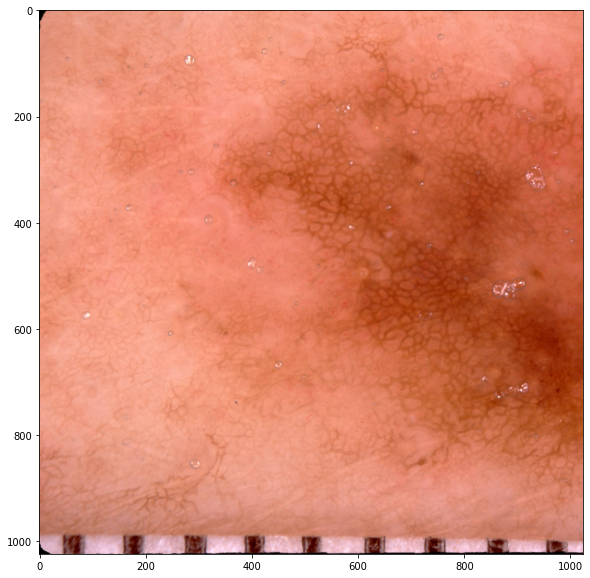

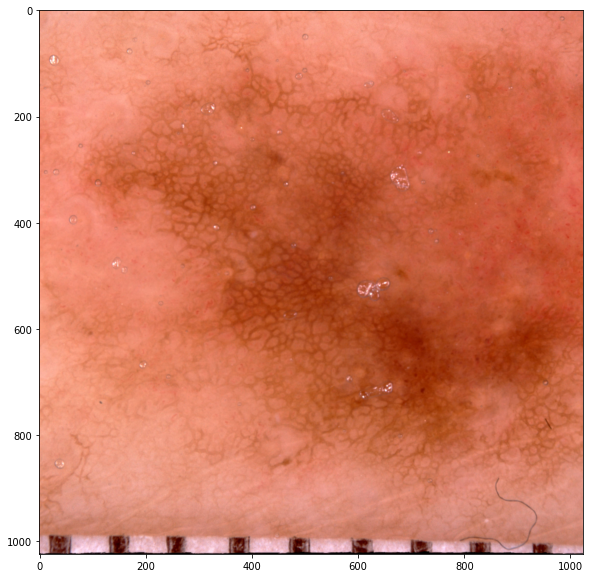

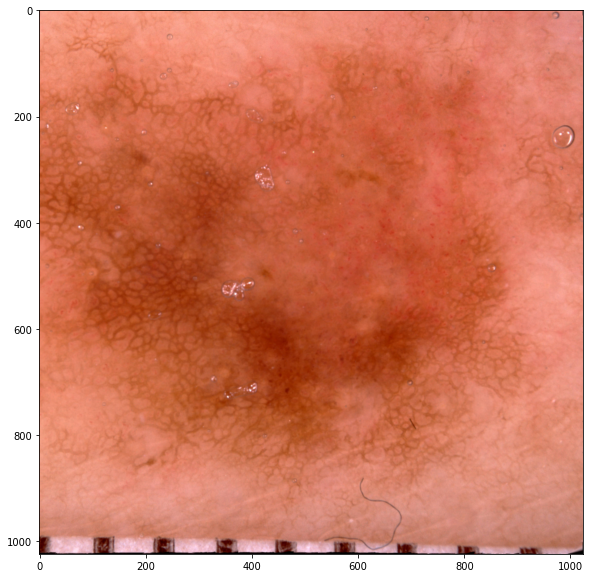

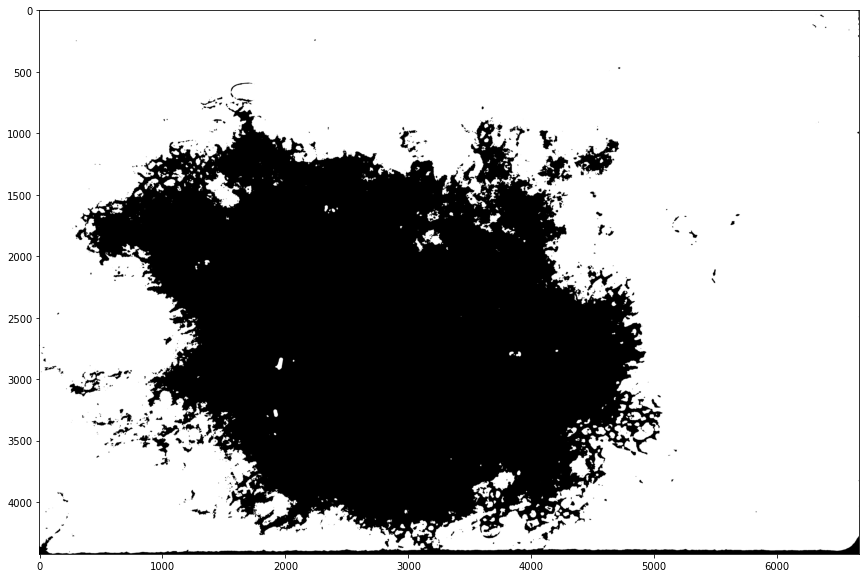

Sx e Dx:  251.16519674355496 245.21981004070557
Up e Down:  254.1603285328533 18.67934293429343
Height e Width: 4422 6666
Height_resized e Width_resized: 1024 1543


KeyboardInterrupt: 

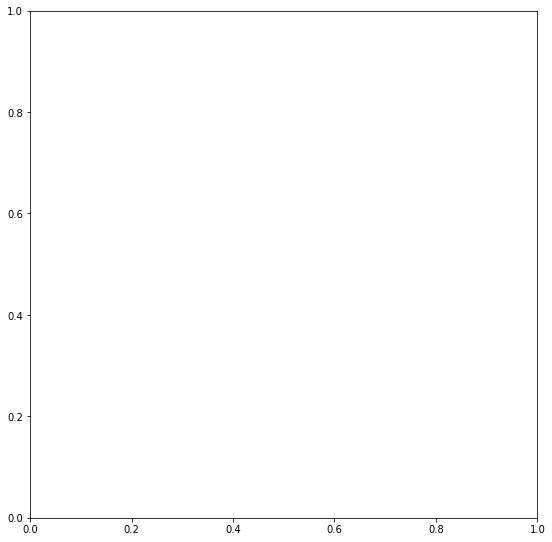

In [22]:
# ---------Dark Corner + WinCrop
HIGH_RES = 1024
THICK = 200
BORDER_THICK = 20
BORDER_THRESH = 10
path = "D:\\DOMI\\University\\Magistrale\\Tesi\\Pipeline_coding\\problemSolving\\dataset_artifact_windowCrop"
images = os.listdir(path)
for image_name in images:
    image = cv2.imread(os.path.join(path, image_name))
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    gray = cv2.GaussianBlur(gray, (5,5), 0)
    _, th = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    height, width, _ = image.shape
    plot_img(cv2.cvtColor(th, cv2.COLOR_BGR2RGB))
    sx_border, dx_border = np.mean(th[:,0:BORDER_THICK]), np.mean(th[:,-BORDER_THICK:])
    up_border, down_border = np.mean(th[0:BORDER_THICK,:]), np.mean(th[-BORDER_THICK:,:])
    # print("Height e Width:", height, width)
    print("Sx e Dx: ", sx_border, dx_border)
    print("Up e Down: ", up_border, down_border)
    # check if first column of image is all black
    if ( (sx_border and dx_border) or (up_border and down_border) or \
         (sx_border and up_border) or (dx_border and down_border) or \
         (sx_border and down_border) or (dx_border and up_border) ) < BORDER_THRESH:
    # if (cv2.countNonZero(image[:,0:5])==0 and cv2.countNonZero(otsu_th[:,-5:])==0) or (cv2.countNonZero(otsu_th[0:5,:])==0 or cv2.countNonZero(otsu_th[-5:,:])==0) \
    #     or (cv2.countNonZero(otsu_th[:,0:5])==0 and cv2.countNonZero(otsu_th[0:5,:])==0) or (cv2.countNonZero(otsu_th[-5:,:])==0 and cv2.countNonZero(otsu_th[:,-5:])==0) \
    #     or (cv2.countNonZero(otsu_th[:,0:5])==0 and cv2.countNonZero(otsu_th[-5:,:])==0) or (cv2.countNonZero(otsu_th[0:5,:])==0 and cv2.countNonZero(otsu_th[:,-5:])==0) :
        th = thresholding(image, kernel_size=50)
        # plot_images(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), th)
        final_image_tmp, _, _ = cropping_to_max_cont(image, th)
        height, width, _ = final_image_tmp.shape
        final_image = center_cropping(final_image_tmp, min(height,width), min(height,width))
        # plot_images(cv2.cvtColor(final_image_tmp, cv2.COLOR_BGR2RGB), cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
        if height > HIGH_RES and width > HIGH_RES:
            final_image = cv2.resize(final_image, (HIGH_RES,HIGH_RES), interpolation=cv2.INTER_AREA)
        elif height < HIGH_RES and width < HIGH_RES:
            final_image = cv2.resize(final_image, (HIGH_RES,HIGH_RES), interpolation=cv2.INTER_CUBIC)

    elif height == width:  #means image is not Dark Corner but it is squared
        if height > HIGH_RES:
            final_image = center_cropping(image, min(height,width), min(height,width))
            final_image = cv2.resize(final_image, (HIGH_RES,HIGH_RES), interpolation=cv2.INTER_AREA)
        else:
            final_image = image
    else: # means that image is not Dark Corner and is rectangular
        print("Height e Width:", height, width)
        THRESH_RATIO = 1000
        if max(height,width)-min(height,width) >= THRESH_RATIO:
            ratio_or = max(height,width)/min(height,width)
            # image = cv2.resize(image, (2*HIGH_RES,3*HIGH_RES), interpolation=cv2.INTER_AREA)
            # height, width, _ = image.shape
            if height < width:
                height_resized = HIGH_RES
                width_resized = int(width*(height_resized/height))
            else:
                width_resized = HIGH_RES
                height_resized = int(height*(width_resized/width))
            ratio_new = max(height_resized,width_resized)/min(height_resized,width_resized)
            resized_image = cv2.resize(image, (width_resized,height_resized), interpolation=cv2.INTER_AREA)
            print("Height_resized e Width_resized:", height_resized, width_resized)
            plot_images(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), cv2.cvtColor(resized_image, cv2.COLOR_BGR2RGB))

            img_a = resized_image[:HIGH_RES,:HIGH_RES]
            img_b = center_cropping(resized_image, HIGH_RES, HIGH_RES)
            img_c = resized_image[-HIGH_RES:,-HIGH_RES:]

            # id_image = file.split('.')[0]
            # reza_file = f'{id_image}_reza.png'
            # rezb_file = f'{id_image}_rezb.png'
            # rezc_file = f'{id_image}_rezc.png'
            
            plot_img(cv2.cvtColor(img_a, cv2.COLOR_BGR2RGB))
            plot_img(cv2.cvtColor(img_b, cv2.COLOR_BGR2RGB))
            plot_img(cv2.cvtColor(img_c, cv2.COLOR_BGR2RGB))
            
        # final_image = center_cropping(image, min(height,width), min(height,width))
        # final_image = cv2.resize(final_image, (HIGH_RES,HIGH_RES), interpolation=cv2.INTER_AREA)
        # if height <= HIGH_RES*3 or width <= HIGH_RES*3:
        #     (winW, winH) = (HIGH_RES, HIGH_RES)
        #     STEPSIZE = HIGH_RES
        # elif height > HIGH_RES*3 or width > HIGH_RES*3:
        #     (winW, winH) = (HIGH_RES*2, HIGH_RES*2)
        #     STEPSIZE = 2*HIGH_RES

        # for (x, y, window) in sliding_window(image, stepSize=STEPSIZE, windowSize=(winW, winH)):
        # # if the window does not meet our desired window size, ignore it
        #     if window.shape[0] != winH  or window.shape[1] != winW:
        #         continue
        #     else:
                # plot_img(cv2.cvtColor(window, cv2.COLOR_BGR2RGB))
                # cv2.rectangle(clone, (x, y), (x + winW, y + winH), (0, 255, 0), 2)

        # final_image = cv2.resize(final_image, (HIGH_RES,HIGH_RES), interpolation=cv2.INTER_AREA)
        
    
        # plot_images(cv2.cvtColor(center_image, cv2.COLOR_BGR2RGB), cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))

    # plot_images(cv2.cvtColor(image, cv2.COLOR_BGR2RGB), cv2.cvtColor(final_image, cv2.COLOR_BGR2RGB))
                    
    # final_image = cv2.resize(final_image, (1024,1024), interpolation=cv2.INTER_AREA)